# Setup

In [1]:
!pip install -q opendatasets

In [3]:
# Kaggle username: hienliu
# Kaggle Key: fafc0c1746c7bbcf0ff2058a5e40bab4
import opendatasets as od
od.download('https://www.kaggle.com/competitions/aptos2019-blindness-detection')

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: hienliu
Your Kaggle Key: ··········


100%|██████████| 9.51G/9.51G [01:41<00:00, 100MB/s]



Extracting archive ./aptos2019-blindness-detection/aptos2019-blindness-detection.zip to ./aptos2019-blindness-detection


In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
import os
import cv2
import torch
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
import matplotlib_inline
from scipy import ndimage
from sklearn.svm import SVC
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from torchvision import transforms
from IPython.display import display
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.ensemble import RandomForestClassifier
from torchvision.models import EfficientNet_V2_S_Weights, efficientnet_v2_s
warnings.filterwarnings('ignore')
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')

# Utils

In [9]:
# @title Load data and convert data
def convert_data(data):
  id_data, y, X = data.T
  X = np.array(X.tolist(), dtype=np.float64)
  y = np.array(y.tolist(), dtype=np.int64)
  return id_data, X, y

def load_data(train_path, test_path):
  train_data = np.load(train_path, allow_pickle=True)
  test_data = np.load(test_path, allow_pickle=True)

  return (
      convert_data(train_data),
      convert_data(test_data)
      )

def get_class_weight(y):
    unique_values, counts = np.unique(y, return_counts=True)
    max_value = max(counts)
    return {c: max_value/v for c, v in zip(unique_values, counts)}

def crop_image_from_gray(img, tol=7):
      if img.ndim ==2:
        mask = img > tol
        return img[np.ix_(mask.any(1),mask.any(0))]
      elif img.ndim==3:
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        mask = gray_img > tol

        check_shape = img[:,:,0][np.ix_(mask.any(1),mask.any(0))].shape[0]
        if (check_shape == 0): # image is too dark so that we crop out everything,
          return img # return original image
        else:
          img1=img[:,:,0][np.ix_(mask.any(1),mask.any(0))]
          img2=img[:,:,1][np.ix_(mask.any(1),mask.any(0))]
          img3=img[:,:,2][np.ix_(mask.any(1),mask.any(0))]
          img = np.stack([img1,img2,img3],axis=-1)
        return img

In [10]:
# @title Train and Evaluate

def fit_and_predict(grid_model, X_train, y_train, X_test):
  grid_model.fit(X_train, y_train)
  y_pred = grid_model.predict(X_test)
  return grid_model, y_pred

def train_model(model, params, X_train, y_train, X_test, cv=5, class_weight=None, train_both=True):

  # Get best params
  if train_both and class_weight:
    bw_model = GridSearchCV(model(class_weight=class_weight), params, cv=cv, n_jobs=-1, scoring='f1_micro')
    model = GridSearchCV(model(), params, cv=cv, n_jobs=-1, scoring='f1_micro')

    return (fit_and_predict(bw_model, X_train, y_train, X_test),
            fit_and_predict(model, X_train, y_train, X_test))

  if class_weight:
    grid_model = GridSearchCV(model(class_weight=class_weight), params, cv=cv, n_jobs=-1, scoring='f1_micro')
  else:
    grid_model = GridSearchCV(model(), params, cv=cv, n_jobs=-1, scoring='f1_micro')

  return fit_and_predict(grid_model, X_train, y_train, X_test)

def display_gridsearch(bw_model, model, cv_column):

  # Combine 2 cv_results
  df1 = pd.DataFrame(bw_model.cv_results_)[cv_column]
  df1['params'] = df1['params'].apply(lambda x: str(x)[:-1] + ", 'class_weight': 'balanced'}")
  df2 = pd.DataFrame(model.cv_results_)[cv_column]
  combine_df = pd.concat([df1, df2], ignore_index=True)

  # Display
  with pd.option_context('display.max_colwidth', None):
    display(combine_df.sort_values(by=['mean_test_score'], ascending=False)[:20])

def report_result(y_test, y_pred, bwy_pred, class_names):

  print('Non-Balance Weight: ')
  print(classification_report(y_test, y_pred))

  print('Balance Weight: ')
  print(classification_report(y_test, bwy_pred))

  corr1 = confusion_matrix(y_test, y_pred)
  corr2 = confusion_matrix(y_test, bwy_pred)

  plt.figure(figsize=(12, 5))

  plt.subplot(1, 2, 1)
  sns.heatmap(corr1, cmap='Blues', linewidths=1, annot=True, xticklabels=class_names, yticklabels=class_names, fmt='g')
  plt.xlabel('Prediction')
  plt.ylabel('Ground Truth')

  plt.subplot(1, 2, 2)
  sns.heatmap(corr2, cmap='Blues', linewidths=1, annot=True, xticklabels=class_names, yticklabels=class_names, fmt='g')
  plt.xlabel('Banlance Weight Prediction')
  plt.ylabel('Ground Truth');

In [11]:
# @title Ploting and Error analysis
def get_data_mask(mask, *args):
    if len(args) == 0 or len(args[0][mask]) == 0:
        return None
    return [data[mask] for data in args]

def get_random_data(class_type, mask1, mask2, *args):

    # Get the class_type
    class_mask = args[3] == class_type
    class_args = get_data_mask(class_mask, *args)

    # Get 2 random mask
    rand_type = np.random.choice([1, 2, 3, 4], size=4, replace=False, p=[0.4, 0.4, 0.1, 0.1])
    type_mask = {1: mask1 & ~mask2,
                 2: ~mask1 & mask2,
                 3: mask1 & mask2,
                 4: ~(mask1 | mask2)}

    valid_mask = []
    save_data = []

    for i in rand_type:
      values = get_data_mask(type_mask[i][class_mask], *class_args) # output tuple or None
      if values is not None:
        save_data.append(values)
        valid_mask.append(i)

      if len(save_data) == 2:
        break

    if len(save_data) < 2:
      values = get_data_mask(type_mask[valid_mask[0]][class_mask], *class_args)
      save_data.append(values)

    if len(valid_mask) < 2:
      rand_idx = np.random.choice(range(0, len(save_data[0][0])), size=2, replace=False) # Pick 2 in 1 mask type
      rand0 = rand_idx[0]
      rand1 = rand_idx[1]
    else:
      rand0 = np.random.randint(0, len(save_data[0][0]), size=1)[0]
      rand1 = np.random.randint(0, len(save_data[1][0]), size=1)[0]

    args0 = get_data_mask(rand0, *save_data[0])
    args1 = get_data_mask(rand1, *save_data[1])

    return args0, args1


def random_plot(image_dir,
                test_id,
                X_test,
                y_test,
                y_pred,
                bwy_pred,
                rgb=True,
                size=384,
                random_seed=None):

  if random_seed:
    np.random.seed(random_seed)

  mask1 = y_test == y_pred
  mask2 = y_test == bwy_pred

  # Plot
  fig = plt.figure(figsize=(14, 12))
  rows, cols = 5, 4

  for i in range(5):

    # Get random idx
    args0, args1 = get_random_data(i, mask1, mask2, test_id, y_pred, bwy_pred, y_test, X_test)

    img_path0 = os.path.join(image_dir, str(args0[0]) + '.png')
    img_path1 = os.path.join(image_dir, str(args1[0]) + '.png')

    img0 = Image.open(img_path0)
    img1 = Image.open(img_path1)

    retina0 = args0[4] != 0
    retina1 = args1[4] != 0

    if not rgb:
      img0 = img0.convert('L')
      img1 = img1.convert('L')

    # Plot Image
    fig.add_subplot(rows, cols, i*cols + 1)
    if not rgb:
      plt.imshow(img0, cmap='gray')
    else:
      plt.imshow(img0)

    plt.title(f'GT: {args0[3]}| NW: {args0[1]}| BW: {args0[2]}')
    plt.axis(False)

    # Plot Histogram
    fig.add_subplot(rows, cols, i*cols + 2)
    ax = sns.histplot(args0[4][retina0] * size**2)
    ax.set(ylabel=None)

    # Plot Image
    fig.add_subplot(rows, cols, i*cols + 3)
    if not rgb:
      plt.imshow(img1, cmap='gray')
    else:
      plt.imshow(img1)

    plt.title(f'GT: {args1[3]}| NW: {args1[1]}| BW: {args1[2]}')
    plt.axis(False)

    # Plot Histogram
    fig.add_subplot(rows, cols, i*cols + 4)
    ax = sns.histplot(args1[4][retina1] * size**2)
    ax.set(ylabel=None)


def plot_feature_2d(train_features, train_hue, test_features, test_hue):
  # Initialize TSNE with 2 components
  tsne = TSNE(n_components=2, random_state=42)

  # Fit TSNE to your data and transform it to the reduced 2-dimensional space
  train_tsne = tsne.fit_transform(train_features)
  test_tsne = tsne.fit_transform(test_features)

  train_df = pd.DataFrame({'Column1': train_tsne[:, 0], 'Column2': train_tsne[:, 1], 'class': train_hue})
  test_df = pd.DataFrame({'Column1': test_tsne[:, 0], 'Column2': test_tsne[:, 1], 'class': test_hue})

  # Plot the reduced data
  plt.figure(figsize=(12, 6))

  plt.subplot(1, 2, 1)
  sns.scatterplot(data=train_df, x='Column1', y='Column2', hue='class')
  plt.title('TSNE Visualization of Train Data')
  plt.xlabel('')
  plt.ylabel('')
  plt.grid(True)

  plt.subplot(1, 2, 2)
  sns.scatterplot(data=test_df, x='Column1', y='Column2', hue='class')
  plt.title('TSNE Visualization of Test Data')
  plt.xlabel('')
  plt.ylabel('')
  plt.grid(True)

def get_fmap(pil_image, model, transform, device='cpu', image_size=384):
  trans_img = transform(pil_image).unsqueeze(0)

  # Get weight and feature
  W = model.classifier[1].weight.data

  model.eval()
  with torch.no_grad():
    feature_map = model.features(trans_img.to(device)) # shape 2, 1280, h, w
    map = feature_map.clone().detach().cpu()
    pooler = model.classifier(model.avgpool(feature_map).squeeze())

  # Get what the model think it is
  chosen_one = pooler.argmax()
  f_map = (W[chosen_one][:, None, None].cpu() * map.squeeze()).sum(0)
  f_map = ndimage.zoom(f_map, (image_size//f_map.shape[0], image_size//f_map.shape[0]))
  return f_map

def plot_feature_map(image_dir,
                     test_id,
                     y_test,
                     y_pred,
                     bwy_pred,
                     model,
                     transform,
                     size=384,
                     device='cpu',
                     random_seed=None):
  if random_seed:
    np.random.seed(random_seed)

  mask1 = y_test == y_pred
  mask2 = y_test == bwy_pred

  fig = plt.figure(figsize=(12, 10))
  rows, cols = 5, 4

  for i in range(5):

    # Setup
    args0, args1 = get_random_data(i, mask1, mask2, test_id, y_pred, bwy_pred, y_test)
    args2, args3 = get_random_data(i, mask1, mask2, test_id, y_pred, bwy_pred, y_test)

    img_path0 = os.path.join(image_dir, str(args0[0]) + '.png')
    img_path1 = os.path.join(image_dir, str(args1[0]) + '.png')
    img_path2 = os.path.join(image_dir, str(args2[0]) + '.png')
    img_path3 = os.path.join(image_dir, str(args3[0]) + '.png')

    img_paths = [img_path0, img_path1, img_path2, img_path3]
    args = [args0, args1, args2, args3]

    # Prepare image
    for idx, (arg, img_path) in enumerate(zip(args, img_paths), start=1):

      img = crop_image_from_gray(cv2.imread(str(img_path)))
      img = Image.fromarray(cv2.resize(img, (size, size)), 'RGB')
      fmap = get_fmap(img, model, transform, device, size)

      fig.add_subplot(rows, cols, i * cols + idx)
      plt.imshow(fmap, cmap='jet', alpha=0.9)
      plt.imshow(img, alpha=0.8)
      plt.title(f'GT: {arg[3]}| NW: {arg[1]}| BW: {arg[2]}')
      plt.axis(False);

def plot_model_decision(test_features, test_hue, pred_hue, bwpred_hue):
  # Get pred hue
  mask1 = pred_hue == test_hue
  matching1 = ['match' if m else 'not match' for m in mask1]
  mask2 = bwpred_hue == test_hue
  matching2 = ['match' if m else 'not match' for m in mask2]

  markers = {"match": "o", "not match": "X"}
  custom_palette = {
        0: '#1f77b4',  # blue
        1: '#ff7f0e',  # orange
        2: '#2ca02c',  # green
        3: '#d62728',  # red
        4: '#9467bd'   # purple
    }

  # Initialize TSNE with 2 components
  tsne = TSNE(n_components=2, random_state=42)

  # Fit TSNE to your data and transform it to the reduced 2-dimensional space
  test_tsne = tsne.fit_transform(test_features)

  test_df = pd.DataFrame({'Column1': test_tsne[:, 0], 'Column2': test_tsne[:, 1], 'class': test_hue})
  pred_df = pd.DataFrame({'Column1': test_tsne[:, 0], 'Column2': test_tsne[:, 1], 'class': pred_hue, 'prediction': matching1})
  bwpred_df = pd.DataFrame({'Column1': test_tsne[:, 0], 'Column2': test_tsne[:, 1], 'class': bwpred_hue, 'prediction': matching2})

  # Plot the reduced data
  plt.figure(figsize=(14, 5))

  plt.subplot(1, 3, 1)
  sns.scatterplot(data=test_df, x='Column1', y='Column2', hue='class', palette=custom_palette)
  plt.title('TSNE Visualization of Test Data')
  plt.xlabel('')
  plt.ylabel('')
  plt.grid(True)

  plt.subplot(1, 3, 2)
  sns.scatterplot(data=pred_df, x='Column1', y='Column2', hue='class', palette=custom_palette, style='prediction', markers=markers)
  plt.title('Non-Balance Weight Model Decision')
  plt.xlabel('')
  plt.ylabel('')
  plt.grid(True)

  # Customize the legend
  legend = plt.legend()

  # Change the markers to dots and turn off legend for specific labels
  for handle in legend.legendHandles:
      if handle.get_label() == 'not match':
          handle._sizes = [40]
          handle.set_marker("X")
      else:
          handle._sizes = [30]
          handle.set_marker("o")  # Set the marker to a dot

  plt.subplot(1, 3, 3)
  sns.scatterplot(data=bwpred_df, x='Column1', y='Column2', hue='class', palette=custom_palette, style='prediction', markers=markers)
  plt.title('Balance Weight Model Decision')
  plt.xlabel('')
  plt.ylabel('')
  plt.grid(True)

  # Customize the legend
  legend = plt.legend()

  # Change the markers to dots and turn off legend for specific labels
  for handle in legend.legendHandles:
      if handle.get_label() == 'not match':
          handle._sizes = [40]
          handle.set_marker("X")
      else:
          handle._sizes = [30]
          handle.set_marker("o")  # Set the marker to a dot

# Config

In [12]:
image_dir = 'aptos2019-blindness-detection/train_images'
histogram_grayscale_train = '/content/drive/MyDrive/UIT/CS/datasets/histogram_grayscale/train_data.npy'
histogram_grayscale_test = '/content/drive/MyDrive/UIT/CS/datasets/histogram_grayscale/test_data.npy'
histogram_rgb_train = 'drive/MyDrive/UIT/CS/datasets/histogram_rgb/train_data.npy'
histogram_rgb_test = 'drive/MyDrive/UIT/CS/datasets/histogram_rgb/test_data.npy'
effnet_train = 'drive/MyDrive/UIT/CS/datasets/efficientnet_v2/train_data.npz'
effnet_test = 'drive/MyDrive/UIT/CS/datasets/efficientnet_v2/test_data.npz'

cv = 5
image_size = 384
std=[0.229, 0.224, 0.225]
mean=[0.485, 0.456, 0.406]
class_names = [0, 1, 2, 3, 4]
device = 'cuda' if torch.cuda.is_available() else 'cpu'
extract_feature = efficientnet_v2_s(weights=EfficientNet_V2_S_Weights.DEFAULT).to(device)

cv_column = ['mean_fit_time',
             'mean_score_time',
             'params',
             'mean_test_score',
             'std_test_score']

class_weight = {0: 1.0,
                1: 4.650735294117647,
                2: 1.8149210903873745,
                3: 9.166666666666666,
                4: 6.62303664921466}

transform = transforms.Compose([
    transforms.Resize((image_size, image_size), interpolation=transforms.InterpolationMode.BILINEAR),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=mean,
        std=std
    )
])

# Model params
rf_param_grid = {
    'n_estimators' : [5, 10, 20, 30, 40, 50],
    'criterion' : ['gini', 'entropy', 'log_loss'],
    'max_depth' : [None, 1, 5, 10, 25, 50],
    'max_features' : ['sqrt', 'log2', None]
}

dt_param_grid = {
    'criterion' : ['gini', 'entropy', 'log_loss'],
    'splitter' : ['best', 'random'],
    'max_depth' : [None, 1, 5, 10, 25, 50],
    'max_features' : ['sqrt', 'log2', None]
}

svc_param_grid = {
    'C': [0.01, 0.05, 0.1, 0.5, 1, 5, 10, 50, 100],
    'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
    'gamma': ['scale', 'auto']
}

Downloading: "https://download.pytorch.org/models/efficientnet_v2_s-dd5fe13b.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_v2_s-dd5fe13b.pth
100%|██████████| 82.7M/82.7M [00:00<00:00, 88.6MB/s]


# Experiment

## Histogram Gray Scale

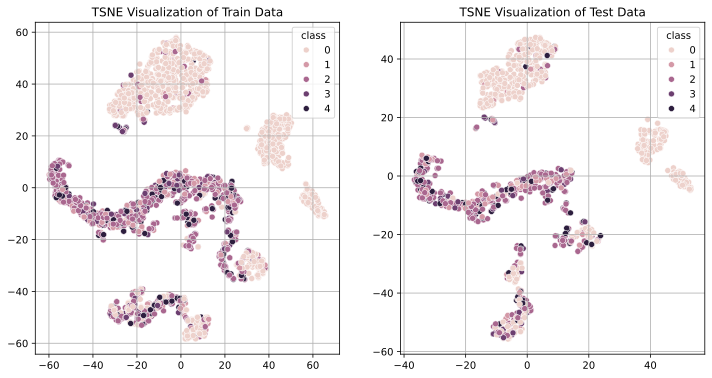

In [13]:
# @title 2D Data
(train_id, X_train, y_train), (test_id, X_test, y_test) = load_data(histogram_grayscale_train,
                                                                    histogram_grayscale_test)

plot_feature_2d(X_train, y_train, X_test, y_test)

### Random Forest

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
196,4.108663,0.011756,"{'criterion': 'entropy', 'max_depth': 25, 'max_features': None, 'n_estimators': 40, 'class_weight': 'balanced'}",0.714403,0.009025
520,4.521989,0.013441,"{'criterion': 'entropy', 'max_depth': 25, 'max_features': None, 'n_estimators': 40}",0.712840,0.005543
539,5.386157,0.018346,"{'criterion': 'entropy', 'max_depth': 50, 'max_features': None, 'n_estimators': 50}",0.712444,0.007558
412,4.611511,0.016198,"{'criterion': 'gini', 'max_depth': 25, 'max_features': None, 'n_estimators': 40}",0.709724,0.011774
214,4.252044,0.015401,"{'criterion': 'entropy', 'max_depth': 50, 'max_features': None, 'n_estimators': 40, 'class_weight': 'balanced'}",0.709335,0.011724
647,5.521445,0.016477,"{'criterion': 'log_loss', 'max_depth': 50, 'max_features': None, 'n_estimators': 50}",0.708547,0.006022
645,3.479229,0.015423,"{'criterion': 'log_loss', 'max_depth': 50, 'max_features': None, 'n_estimators': 30}",0.707769,0.008322
627,3.530838,0.011691,"{'criterion': 'log_loss', 'max_depth': 25, 'max_features': None, 'n_estimators': 30}",0.707766,0.004217
322,3.550794,0.013648,"{'criterion': 'log_loss', 'max_depth': 50, 'max_features': None, 'n_estimators': 40, 'class_weight': 'balanced'}",0.707764,0.009026
449,4.804664,0.015668,"{'criterion': 'entropy', 'max_depth': None, 'max_features': None, 'n_estimators': 50}",0.707385,0.013214


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.89      0.93      0.91       542
           1       0.39      0.28      0.33       111
           2       0.55      0.76      0.64       300
           3       0.35      0.10      0.16        58
           4       0.32      0.09      0.14        88

    accuracy                           0.71      1099
   macro avg       0.50      0.43      0.43      1099
weighted avg       0.67      0.71      0.68      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.90      0.92      0.91       542
           1       0.35      0.28      0.31       111
           2       0.55      0.76      0.64       300
           3       0.33      0.10      0.16        58
           4       0.21      0.07      0.10        88

    accuracy                           0.70      1099
   macro avg       0.47      0.43      0.42      1099
weighted avg       0.67      0.70      

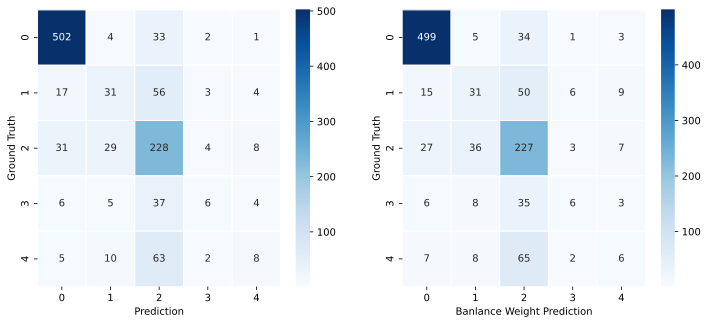

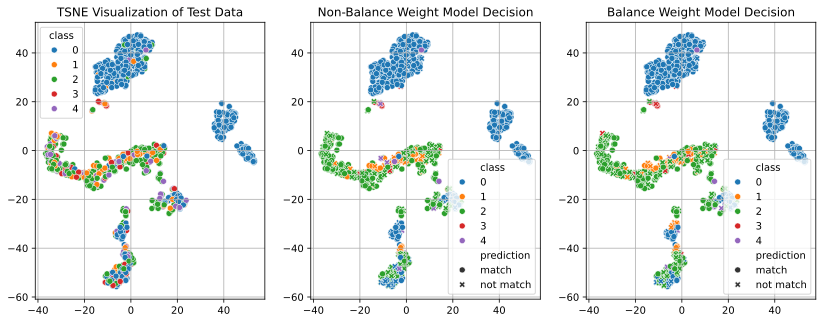

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=RandomForestClassifier,
                                                    params=rf_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

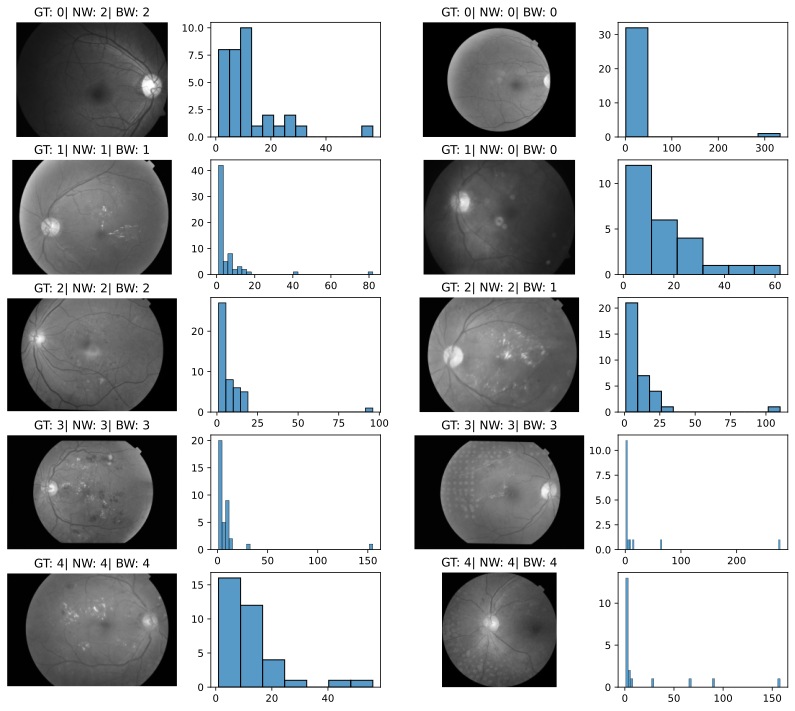

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred, rgb=False)

### Decision Tree

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
160,0.119549,0.006637,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.686310,0.015955
196,0.117535,0.006924,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.685529,0.015474
161,0.037637,0.006554,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.680457,0.014567
125,0.021108,0.003237,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.678120,0.015018
197,0.042590,0.007329,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.677336,0.009438
124,0.049427,0.003387,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.673820,0.014981
203,0.061552,0.006623,"{'criterion': 'log_loss', 'max_depth': 10, 'max_features': None, 'splitter': 'random'}",0.667966,0.013049
131,0.033389,0.003240,"{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'splitter': 'random'}",0.666789,0.018563
166,0.193202,0.004504,"{'criterion': 'entropy', 'max_depth': 10, 'max_features': None, 'splitter': 'best'}",0.665630,0.018988
202,0.156407,0.004682,"{'criterion': 'log_loss', 'max_depth': 10, 'max_features': None, 'splitter': 'best'}",0.665240,0.020853


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.87      0.88      0.88       542
           1       0.43      0.03      0.05       111
           2       0.48      0.85      0.61       300
           3       0.33      0.02      0.03        58
           4       0.00      0.00      0.00        88

    accuracy                           0.67      1099
   macro avg       0.42      0.36      0.31      1099
weighted avg       0.62      0.67      0.61      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.89      0.85      0.87       542
           1       0.28      0.27      0.27       111
           2       0.53      0.51      0.52       300
           3       0.16      0.16      0.16        58
           4       0.16      0.25      0.20        88

    accuracy                           0.61      1099
   macro avg       0.41      0.41      0.40      1099
weighted avg       0.63      0.61      

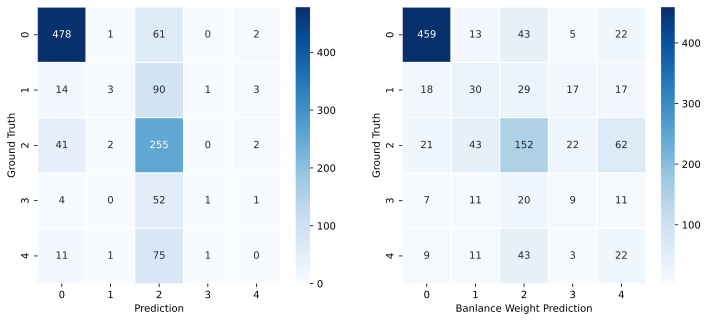

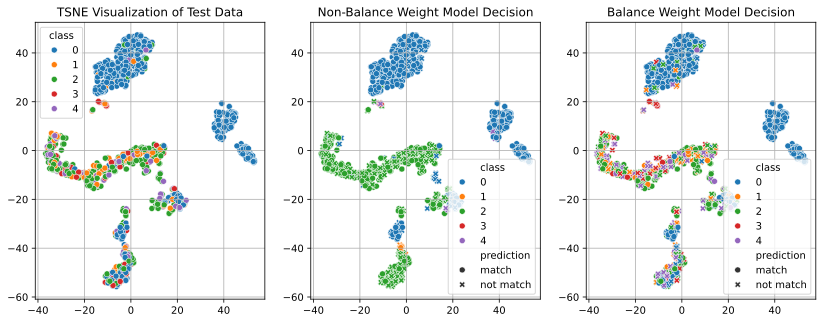

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=DecisionTreeClassifier,
                                                    params=dt_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

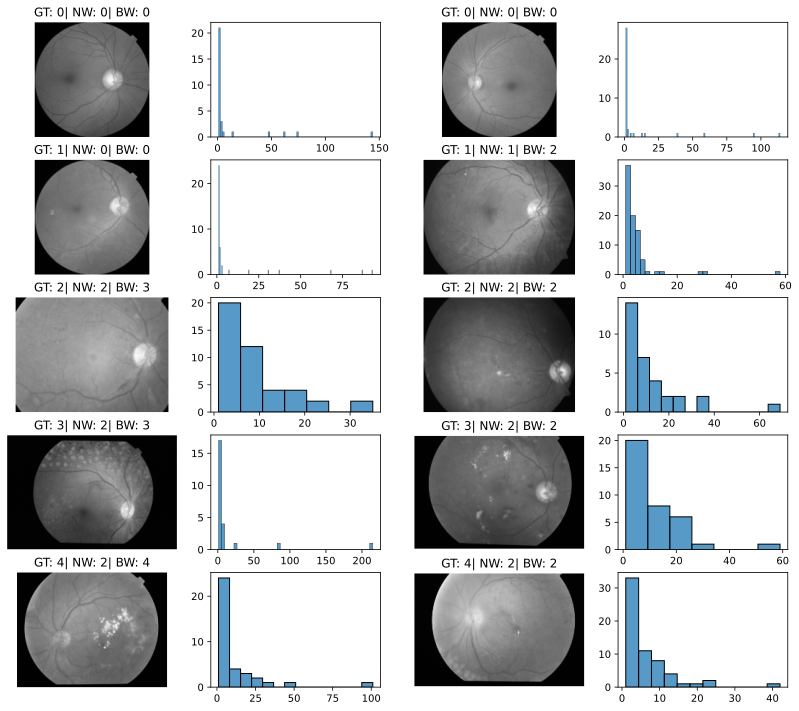

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred, rgb=False)

### SVC

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
113,0.964108,0.460009,"{'C': 5, 'gamma': 'scale', 'kernel': 'rbf'}",0.708938,0.010331
121,0.666374,0.266542,"{'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}",0.704643,0.008405
130,0.861882,0.147458,"{'C': 50, 'gamma': 'scale', 'kernel': 'poly'}",0.703478,0.009695
105,0.659009,0.265308,"{'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}",0.702694,0.009217
97,1.014054,0.457732,"{'C': 0.5, 'gamma': 'scale', 'kernel': 'rbf'}",0.702306,0.008793
122,0.712334,0.111306,"{'C': 10, 'gamma': 'scale', 'kernel': 'poly'}",0.701135,0.006959
114,1.117424,0.190059,"{'C': 5, 'gamma': 'scale', 'kernel': 'poly'}",0.696840,0.008310
138,0.953823,0.120366,"{'C': 100, 'gamma': 'scale', 'kernel': 'poly'}",0.694896,0.008697
89,0.761950,0.285470,"{'C': 0.1, 'gamma': 'scale', 'kernel': 'rbf'}",0.692942,0.005361
129,0.754221,0.306165,"{'C': 50, 'gamma': 'scale', 'kernel': 'rbf'}",0.685921,0.006931


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.88      0.92      0.90       542
           1       0.43      0.03      0.05       111
           2       0.52      0.89      0.66       300
           3       0.58      0.12      0.20        58
           4       0.00      0.00      0.00        88

    accuracy                           0.71      1099
   macro avg       0.48      0.39      0.36      1099
weighted avg       0.65      0.71      0.64      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.90      0.89      0.90       542
           1       0.34      0.44      0.38       111
           2       0.64      0.51      0.57       300
           3       0.13      0.16      0.14        58
           4       0.25      0.31      0.28        88

    accuracy                           0.66      1099
   macro avg       0.45      0.46      0.45      1099
weighted avg       0.68      0.66      

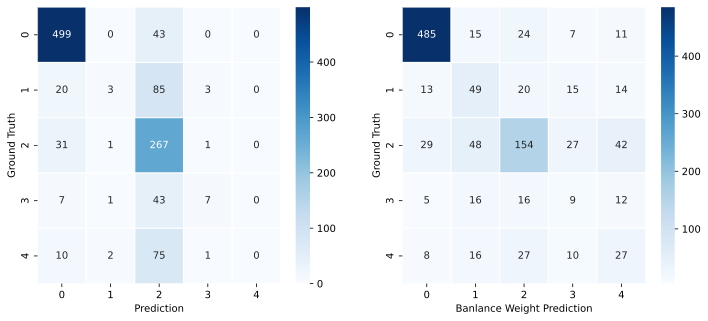

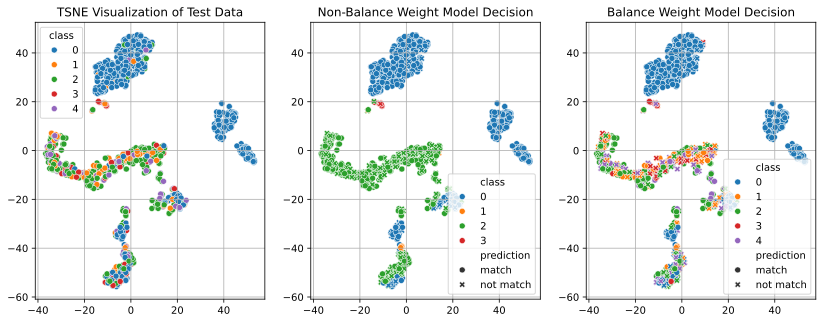

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=SVC,
                                                    params=svc_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

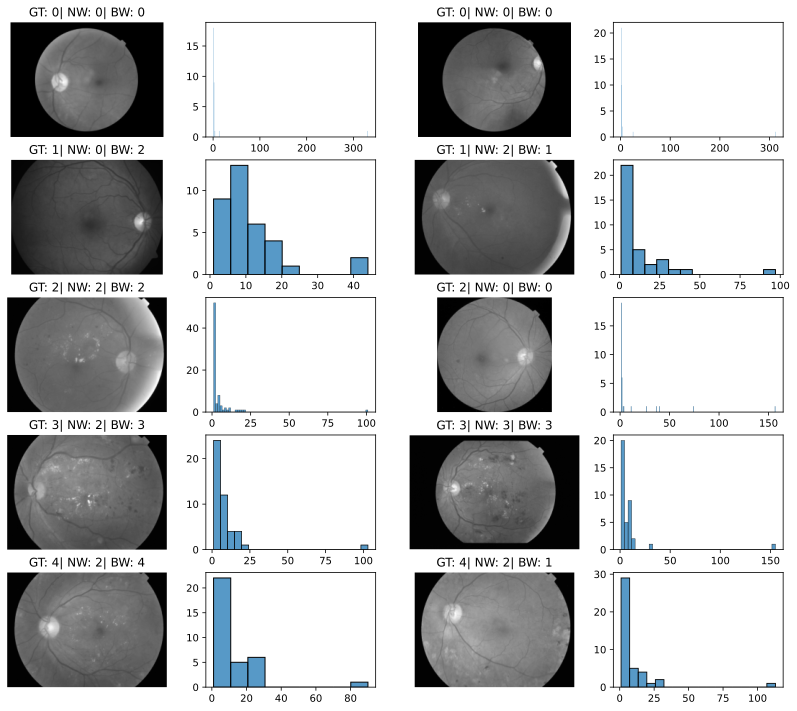

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred, rgb=False)

## Histogram RGB

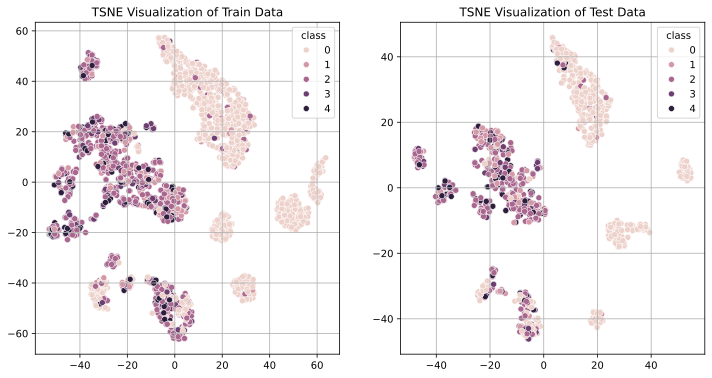

In [14]:
# @title 2D Data
(train_id, X_train, y_train), (test_id, X_test, y_test) = load_data(histogram_rgb_train,
                                                                    histogram_rgb_test)
plot_feature_2d(X_train, y_train, X_test, y_test)

### Random Forest

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
215,12.881905,0.018108,"{'criterion': 'entropy', 'max_depth': 50, 'max_features': None, 'n_estimators': 50, 'class_weight': 'balanced'}",0.732346,0.007985
554,5.516851,0.009457,"{'criterion': 'log_loss', 'max_depth': None, 'max_features': None, 'n_estimators': 20}",0.731570,0.017579
305,12.630272,0.013533,"{'criterion': 'log_loss', 'max_depth': 25, 'max_features': None, 'n_estimators': 50, 'class_weight': 'balanced'}",0.731564,0.008969
323,12.529843,0.012717,"{'criterion': 'log_loss', 'max_depth': 50, 'max_features': None, 'n_estimators': 50, 'class_weight': 'balanced'}",0.731176,0.011763
501,7.032882,0.009392,"{'criterion': 'entropy', 'max_depth': 10, 'max_features': None, 'n_estimators': 30}",0.730787,0.017679
629,12.723826,0.017530,"{'criterion': 'log_loss', 'max_depth': 25, 'max_features': None, 'n_estimators': 50}",0.730402,0.011949
214,10.121871,0.017250,"{'criterion': 'entropy', 'max_depth': 50, 'max_features': None, 'n_estimators': 40, 'class_weight': 'balanced'}",0.730007,0.008034
233,12.913147,0.016925,"{'criterion': 'log_loss', 'max_depth': None, 'max_features': None, 'n_estimators': 50, 'class_weight': 'balanced'}",0.730003,0.006287
124,10.290245,0.018676,"{'criterion': 'entropy', 'max_depth': None, 'max_features': None, 'n_estimators': 40, 'class_weight': 'balanced'}",0.729620,0.013133
521,12.886657,0.015400,"{'criterion': 'entropy', 'max_depth': 25, 'max_features': None, 'n_estimators': 50}",0.729617,0.012425


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.92      0.94      0.93       542
           1       0.33      0.28      0.30       111
           2       0.57      0.75      0.65       300
           3       0.37      0.12      0.18        58
           4       0.26      0.10      0.15        88

    accuracy                           0.71      1099
   macro avg       0.49      0.44      0.44      1099
weighted avg       0.68      0.71      0.69      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.93      0.94      0.94       542
           1       0.38      0.32      0.34       111
           2       0.57      0.80      0.67       300
           3       0.54      0.12      0.20        58
           4       0.44      0.12      0.19        88

    accuracy                           0.73      1099
   macro avg       0.57      0.46      0.47      1099
weighted avg       0.72      0.73      

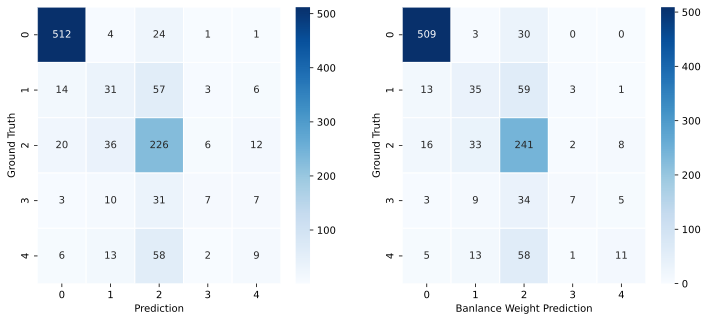

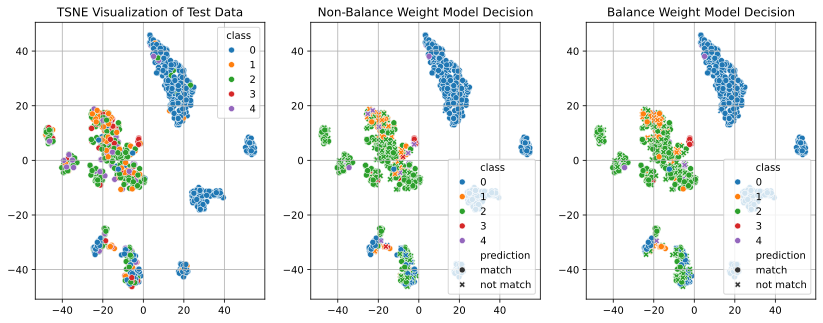

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=RandomForestClassifier,
                                                    params=rf_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

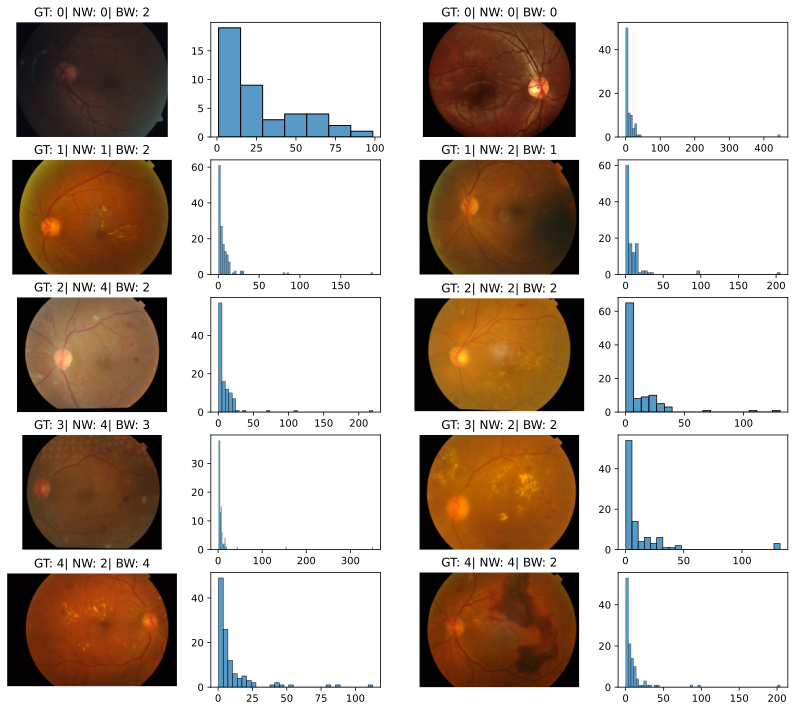

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred)

### Decision Tree

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
160,0.145585,0.003345,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.715178,0.015661
196,0.475096,0.008630,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.715178,0.015661
124,0.236873,0.004927,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.701138,0.013048
125,0.051811,0.004619,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.698406,0.010185
161,0.023826,0.003301,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.696458,0.009499
197,0.059563,0.004890,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.691769,0.006304
118,0.045077,0.004981,"{'criterion': 'gini', 'max_depth': 1, 'max_features': None, 'splitter': 'best'}",0.680064,0.004292
154,0.031407,0.003082,"{'criterion': 'entropy', 'max_depth': 1, 'max_features': None, 'splitter': 'best'}",0.680064,0.004292
190,0.031563,0.003013,"{'criterion': 'log_loss', 'max_depth': 1, 'max_features': None, 'splitter': 'best'}",0.680064,0.004292
131,0.044408,0.003337,"{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'splitter': 'random'}",0.678116,0.006886


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.90      0.93      0.92       542
           1       0.33      0.27      0.30       111
           2       0.56      0.79      0.66       300
           3       0.46      0.19      0.27        58
           4       0.00      0.00      0.00        88

    accuracy                           0.71      1099
   macro avg       0.45      0.44      0.43      1099
weighted avg       0.66      0.71      0.68      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.91      0.88      0.89       542
           1       0.35      0.35      0.35       111
           2       0.54      0.57      0.55       300
           3       0.17      0.17      0.17        58
           4       0.22      0.22      0.22        88

    accuracy                           0.65      1099
   macro avg       0.44      0.44      0.44      1099
weighted avg       0.66      0.65      

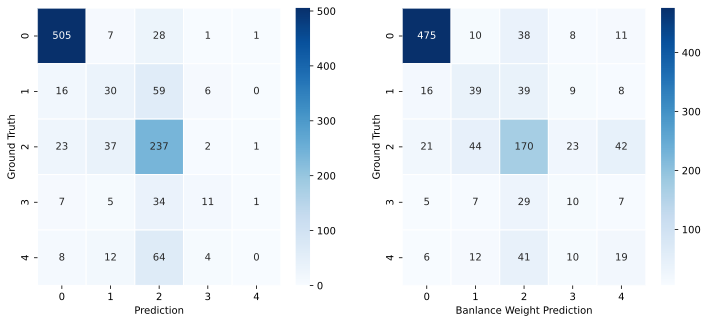

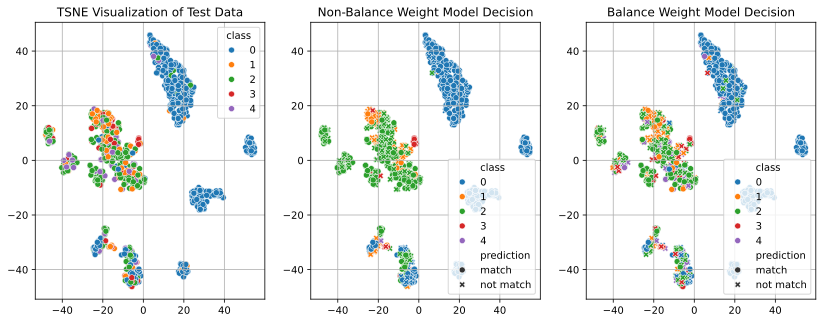

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=DecisionTreeClassifier,
                                                    params=dt_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

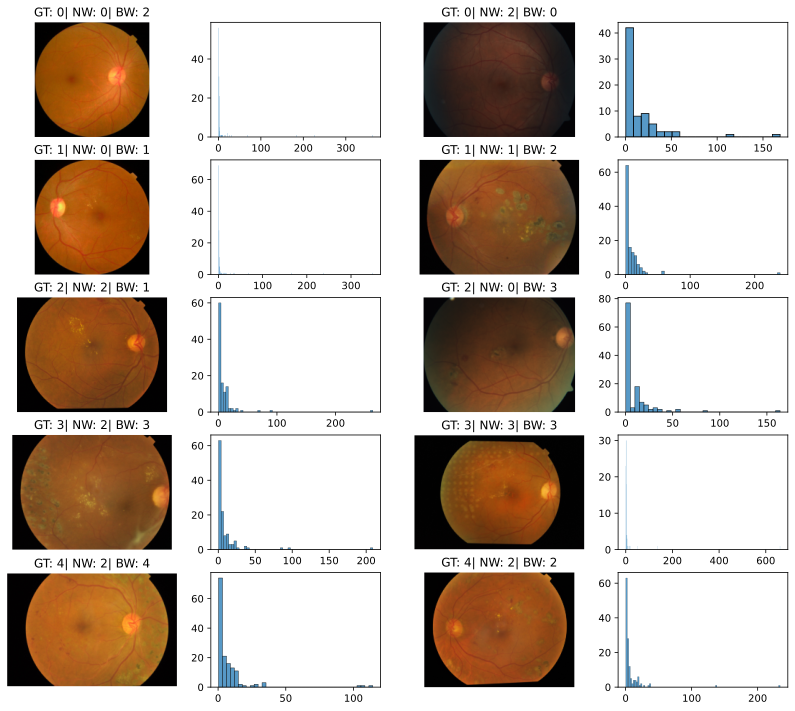

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred)

### SVC

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
121,0.740028,0.281063,"{'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}",0.722205,0.012151
138,0.972897,0.154937,"{'C': 100, 'gamma': 'scale', 'kernel': 'poly'}",0.717519,0.008642
113,0.648572,0.306494,"{'C': 5, 'gamma': 'scale', 'kernel': 'rbf'}",0.716743,0.010069
129,0.892710,0.370097,"{'C': 50, 'gamma': 'scale', 'kernel': 'rbf'}",0.715962,0.010263
130,0.908453,0.147602,"{'C': 50, 'gamma': 'scale', 'kernel': 'poly'}",0.715181,0.012857
105,1.122399,0.620284,"{'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}",0.714402,0.011221
137,2.078287,0.678064,"{'C': 100, 'gamma': 'scale', 'kernel': 'rbf'}",0.712842,0.010782
97,0.583230,0.253974,"{'C': 0.5, 'gamma': 'scale', 'kernel': 'rbf'}",0.711672,0.009892
122,0.849844,0.147385,"{'C': 10, 'gamma': 'scale', 'kernel': 'poly'}",0.699574,0.009297
106,1.470995,0.198630,"{'C': 1, 'gamma': 'scale', 'kernel': 'poly'}",0.684356,0.007044


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.92      0.94      0.93       542
           1       0.40      0.26      0.32       111
           2       0.55      0.84      0.67       300
           3       0.62      0.14      0.23        58
           4       0.00      0.00      0.00        88

    accuracy                           0.73      1099
   macro avg       0.50      0.44      0.43      1099
weighted avg       0.67      0.73      0.68      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.93      0.93      0.93       542
           1       0.31      0.48      0.38       111
           2       0.60      0.48      0.53       300
           3       0.10      0.09      0.09        58
           4       0.21      0.24      0.23        88

    accuracy                           0.66      1099
   macro avg       0.43      0.44      0.43      1099
weighted avg       0.68      0.66      

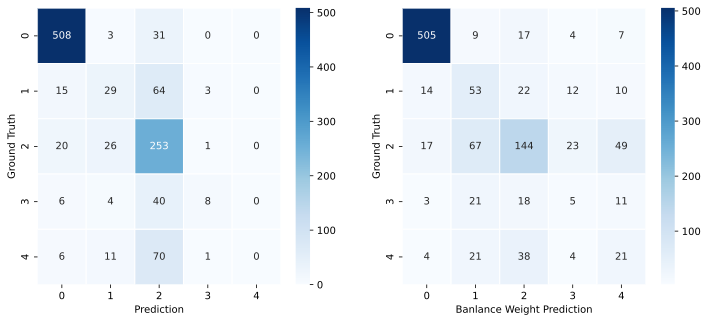

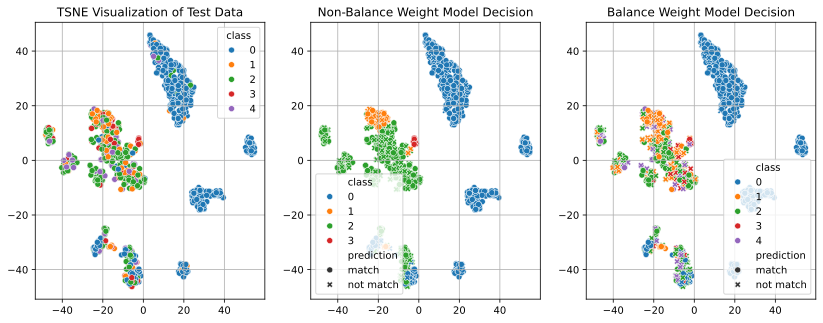

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=SVC,
                                                    params=svc_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

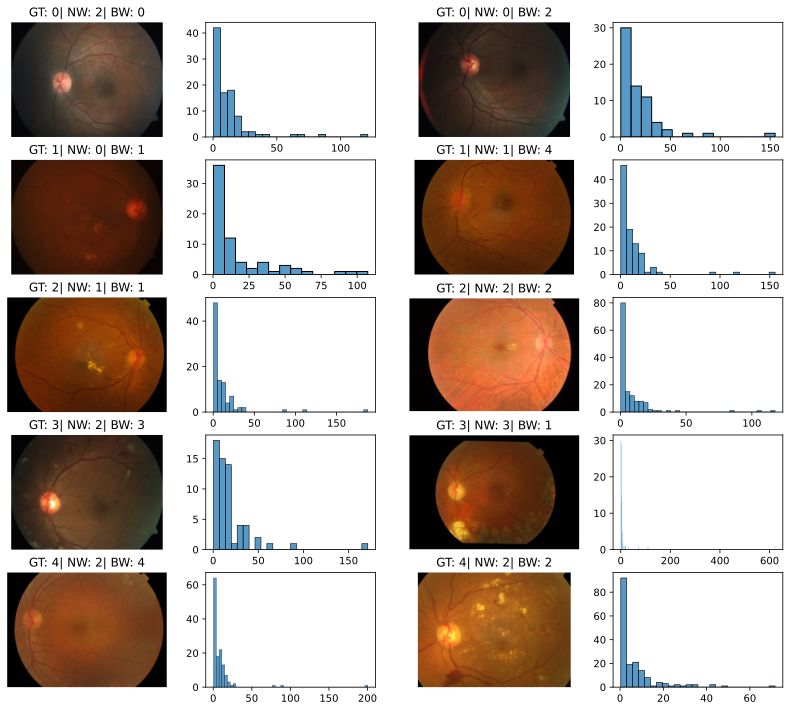

In [ ]:
# @title Random Plot
random_plot(image_dir, test_id, X_test, y_test, y_pred, bwy_pred)

## EfficientNet-V2

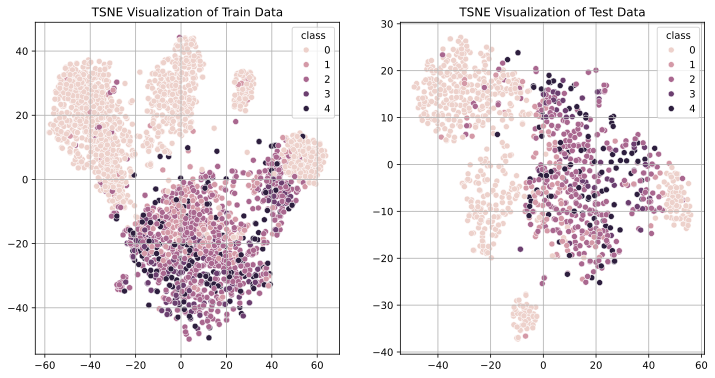

In [15]:
# @title 2D Data
train_data = np.load('/content/drive/MyDrive/UIT/CS/datasets/efficientnet_v2/train_data.npz')
test_data = np.load('/content/drive/MyDrive/UIT/CS/datasets/efficientnet_v2/test_data.npz')

train_id, X_train, y_train = train_data['train_id'], train_data['train_features'], train_data['train_labels']
test_id, X_test, y_test = test_data['test_id'], test_data['test_features'], test_data['test_labels']

plot_feature_2d(X_train, y_train, X_test, y_test)

### Random Forest

Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.94      0.98      0.96       540
           1       0.52      0.23      0.32        98
           2       0.61      0.87      0.72       302
           3       0.36      0.15      0.21        55
           4       0.63      0.21      0.32       104

    accuracy                           0.77      1099
   macro avg       0.61      0.49      0.51      1099
weighted avg       0.75      0.77      0.74      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.93      0.99      0.96       540
           1       0.62      0.29      0.39        98
           2       0.59      0.87      0.71       302
           3       0.19      0.05      0.08        55
           4       0.76      0.18      0.29       104

    accuracy                           0.77      1099
   macro avg       0.62      0.48      0.49      1099
weighted avg       0.76      0.77      

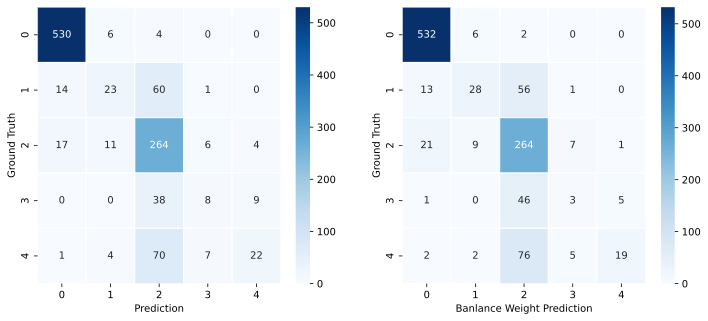

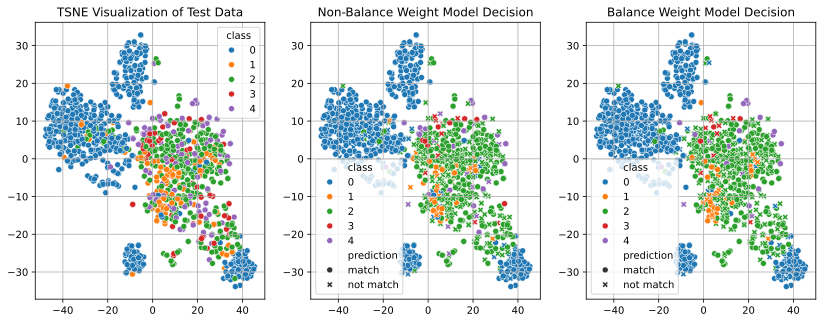

In [ ]:
# @title Training and Evaluate
# @markdown [Hyperparameter Tuning Here.](https://www.kaggle.com/code/liuthehien/randomforesttraining)

bw_model = RandomForestClassifier(**{'class_weight': {0: 1.0, 1: 4.650735294117647, 2: 1.8149210903873745, 3: 9.166666666666666, 4: 6.62303664921466}, 'criterion': 'entropy', 'max_depth': 25, 'max_features': None, 'n_estimators': 50})
bw_model.fit(X_train, y_train)
bwy_pred = bw_model.predict(X_test)

model = RandomForestClassifier(**{'criterion': 'entropy', 'max_depth': None, 'max_features': None, 'n_estimators': 50})
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

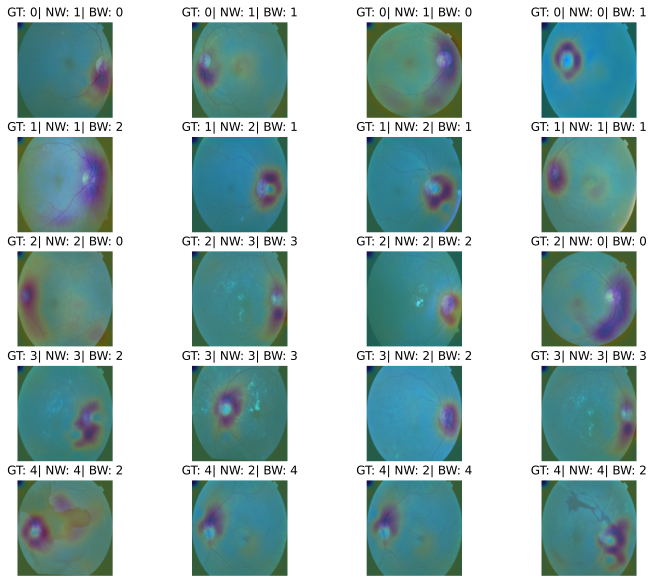

In [ ]:
# @title Plot Random Feature Map
plot_feature_map(image_dir, test_id, y_test, y_pred, bwy_pred, extract_feature, transform, device=device)

### Decision Tree

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
161,0.192143,0.003249,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.714017,0.011235
124,2.823502,0.003334,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.711653,0.015681
197,0.210513,0.004267,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.701910,0.008560
196,5.511584,0.003312,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.698392,0.012647
160,6.085357,0.004360,"{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'splitter': 'best'}",0.697611,0.012122
192,0.262019,0.009611,"{'criterion': 'log_loss', 'max_depth': 5, 'max_features': 'sqrt', 'splitter': 'best'}",0.691379,0.013433
125,0.192875,0.003402,"{'criterion': 'gini', 'max_depth': 5, 'max_features': None, 'splitter': 'random'}",0.690977,0.016077
120,0.119419,0.007418,"{'criterion': 'gini', 'max_depth': 5, 'max_features': 'sqrt', 'splitter': 'best'}",0.690211,0.010518
179,0.391331,0.003393,"{'criterion': 'entropy', 'max_depth': 50, 'max_features': None, 'splitter': 'random'}",0.683566,0.025002
131,0.344787,0.003424,"{'criterion': 'gini', 'max_depth': 10, 'max_features': None, 'splitter': 'random'}",0.682793,0.018022


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.88      0.92      0.90       540
           1       0.29      0.18      0.22        98
           2       0.54      0.76      0.63       302
           3       0.26      0.15      0.19        55
           4       0.18      0.03      0.05       104

    accuracy                           0.69      1099
   macro avg       0.43      0.41      0.40      1099
weighted avg       0.64      0.69      0.65      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.89      0.88      0.89       540
           1       0.22      0.23      0.23        98
           2       0.55      0.57      0.56       302
           3       0.13      0.15      0.14        55
           4       0.32      0.26      0.29       104

    accuracy                           0.64      1099
   macro avg       0.42      0.42      0.42      1099
weighted avg       0.64      0.64      

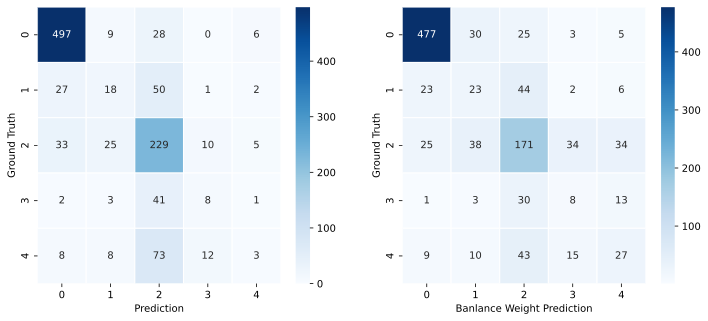

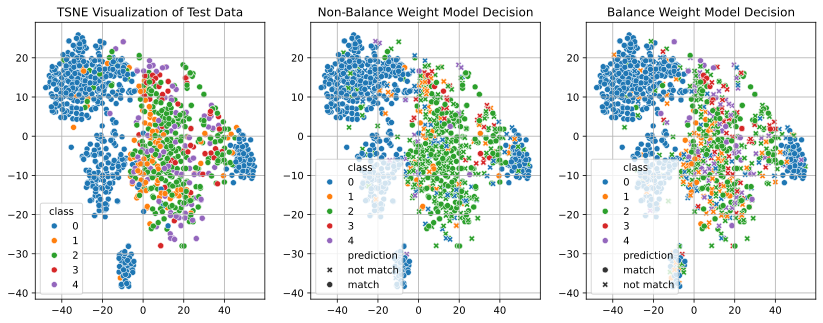

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=DecisionTreeClassifier,
                                                    params=dt_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

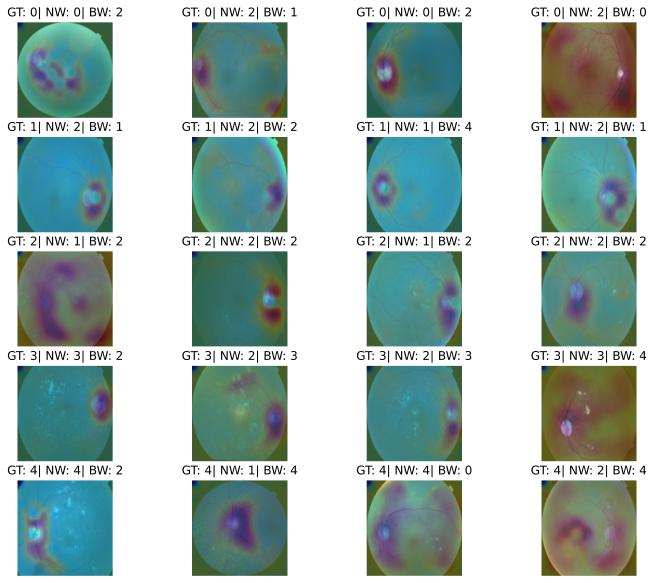

In [ ]:
# @title Plot Random Feature Map
plot_feature_map(image_dir, test_id, y_test, y_pred, bwy_pred, extract_feature, transform, device=device)

### SVC

,mean_fit_time,mean_score_time,params,mean_test_score,std_test_score
121,2.528929,1.292156,"{'C': 10, 'gamma': 'scale', 'kernel': 'rbf'}",0.826764,0.008349
113,2.029421,1.246546,"{'C': 5, 'gamma': 'scale', 'kernel': 'rbf'}",0.820127,0.007981
143,2.396421,0.599658,"{'C': 100, 'gamma': 'auto', 'kernel': 'sigmoid'}",0.819737,0.009634
88,1.817106,0.458242,"{'C': 0.1, 'gamma': 'scale', 'kernel': 'linear'}",0.819347,0.011640
92,1.887647,0.562802,"{'C': 0.1, 'gamma': 'auto', 'kernel': 'linear'}",0.819347,0.011640
133,2.254340,1.271494,"{'C': 50, 'gamma': 'auto', 'kernel': 'rbf'}",0.817785,0.011120
80,2.345520,0.607414,"{'C': 0.05, 'gamma': 'scale', 'kernel': 'linear'}",0.817393,0.010071
84,1.856963,0.543005,"{'C': 0.05, 'gamma': 'auto', 'kernel': 'linear'}",0.817393,0.010071
122,1.952045,0.531808,"{'C': 10, 'gamma': 'scale', 'kernel': 'poly'}",0.814666,0.009251
141,1.747067,1.208427,"{'C': 100, 'gamma': 'auto', 'kernel': 'rbf'}",0.814277,0.011252


Non-Balance Weight: 
              precision    recall  f1-score   support

           0       0.97      0.98      0.98       540
           1       0.63      0.58      0.61        98
           2       0.71      0.85      0.77       302
           3       0.45      0.36      0.40        55
           4       0.74      0.40      0.52       104

    accuracy                           0.82      1099
   macro avg       0.70      0.64      0.66      1099
weighted avg       0.82      0.82      0.82      1099

Balance Weight: 
              precision    recall  f1-score   support

           0       0.97      0.98      0.98       540
           1       0.55      0.68      0.61        98
           2       0.73      0.72      0.72       302
           3       0.32      0.38      0.35        55
           4       0.65      0.45      0.53       104

    accuracy                           0.80      1099
   macro avg       0.64      0.64      0.64      1099
weighted avg       0.81      0.80      

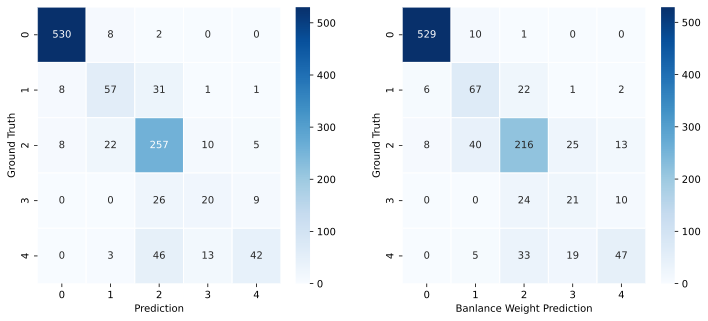

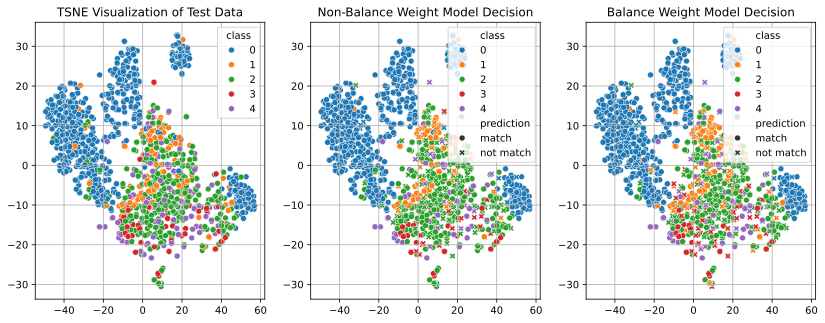

In [ ]:
# @title Training and Evaluate
(bw_model, bwy_pred), (model, y_pred) = train_model(model=SVC,
                                                    params=svc_param_grid,
                                                    X_train=X_train,
                                                    y_train=y_train,
                                                    X_test=X_test,
                                                    cv=cv,
                                                    class_weight=class_weight,
                                                    train_both=True)

display_gridsearch(bw_model, model, cv_column)
report_result(y_test, y_pred, bwy_pred, class_names)
plot_model_decision(X_test, y_test, y_pred, bwy_pred)

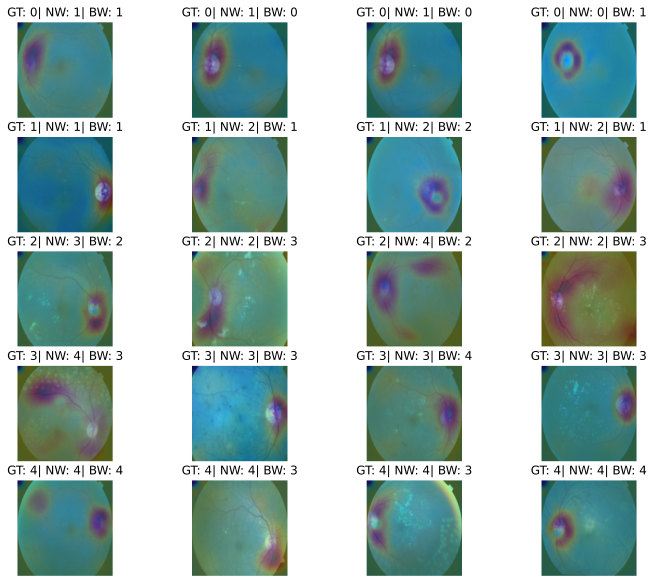

In [ ]:
# @title Plot Random Feature Map
plot_feature_map(image_dir, test_id, y_test, y_pred, bwy_pred, extract_feature, transform, device=device)